Necessary libraries: pandas, gensim, sklearn, wrds

### Data preprocessing

#### Importing the data

In [ ]:
# # load the file into a pandas dataframe
# holdings_df = pd.read_csv('13f_2020_01-2023_12.csv')

Download 13f and returns data from WRDS:

In [23]:
import wrds
import pandas as pd

In [25]:
conn = wrds.Connection()

WRDS recommends setting up a .pgpass file.
Created .pgpass file successfully.
You can create this file yourself at any time with the create_pgpass_file() function.
Loading library list...
Done


In [ ]:
query = f"""
    SELECT cik, fdate, fname, cusip, value
    FROM wrdssec_all.wrds_13f_holdings
    WHERE fdate BETWEEN '2020-01-01' AND '2023-12-31'
"""

In [ ]:
holdings_df = conn.raw_sql(query)

In [ ]:
holdings_df.head()

In [ ]:
holdings_df.to_csv('13f_holdings.csv')

In [26]:
cusip_list = holdings_df['cusip'].unique()

In [27]:
cusip_list_str = ", ".join(f"'{cusip}'" for cusip in cusip_list)

In [28]:
query = f"""
    SELECT cusip, datadate, prccd
    FROM comp_na_daily_all.secd
    WHERE cusip IN ({cusip_list_str})
      AND datadate BETWEEN '2020-01-01' AND '2023-12-31'
"""

In [29]:
# Execute the query and fetch the data
data = conn.raw_sql(query)

In [30]:
data.head()

,cusip,datadate,prccd
0,000361105,2020-01-02,45.75
1,02376R102,2020-01-02,29.09
2,125141101,2020-01-02,7.68
3,G3156P103,2020-01-02,13.70
4,002444107,2020-01-02,20.45


In [39]:
data.to_csv('cusip_returns.csv')

In [38]:
conn.close()

In [40]:
data

,cusip,datadate,prccd
0,000361105,2020-01-02,45.7500
1,02376R102,2020-01-02,29.0900
2,125141101,2020-01-02,7.6800
3,G3156P103,2020-01-02,13.7000
4,002444107,2020-01-02,20.4500
...,...,...,...
449312,G4232K100,2023-12-29,4.1000
449313,405552100,2023-12-29,8.2300
449314,00449R109,2023-12-29,31.2010
449315,46436E262,2023-12-29,51.9389


Alternatively, load from memory:

In [145]:
data = pd.read_csv('cusip_returns.csv')
holdings_df = pd.read_csv('13f_holdings.csv')

#### Creating baskets of returns

In [146]:
# convert datadate to datetime
data['datadate'] = pd.to_datetime(data['datadate'])

# calculate quarterly returns
quarterly_returns = (
    data.set_index('datadate')  # Set datadate as the index
      .groupby('cusip')['prccd']  # Group by cusip
      .resample('QE')  # Resample to quarterly frequency
      .agg(['first', 'last'])  # Get first and last prices in each quarter
      .dropna()  # Remove rows with NaN values
)
quarterly_returns['Quarterly Return'] = (
    quarterly_returns['last'] / quarterly_returns['first'] - 1
)
quarterly_returns = quarterly_returns.reset_index()  # Reset the index

# add a 'Quarter' column
quarterly_returns['Quarter'] = quarterly_returns['datadate'].dt.to_period('Q')

# organize the final DataFrame
returns = quarterly_returns[['cusip', 'Quarter', 'Quarterly Return']]

We use quantile-based return baskets:

In [147]:
pd.options.mode.chained_assignment = None # suppress warning which is a false positive

def create_baskets_with_quantiles(df, quarter_col="Quarter", return_col="Quarterly Return", num_bins=5):
    baskets = {}
    for quarter in df[quarter_col].unique():
        quarter_data = df[df[quarter_col] == quarter]
        
        # Generate quantile-based bins
        quantiles = pd.qcut(quarter_data[return_col], q=num_bins, duplicates='drop')
        quarter_data["Return Range"] = quantiles
        
        # Group CUSIPs by return range
        basket = quarter_data.groupby("Return Range", observed=False)["cusip"].apply(list).to_dict()
        baskets[quarter] = basket
    return baskets

# create baskets
baskets = create_baskets_with_quantiles(returns, num_bins=25)

In [148]:
def create_sub_buckets(baskets):
    sub_baskets = {}  # Initialize the dictionary to store sub-buckets
    for quarter, bucket_dict in baskets.items():
        sub_baskets[quarter] = {}  # Initialize for each quarter
        for bucket_label, cusips in bucket_dict.items():
            # Generate new buckets by removing one element at a time
            sub_baskets[quarter][bucket_label] = [
                [cusip for i, cusip in enumerate(cusips) if i != idx]
                for idx in range(len(cusips))
            ]
    return sub_baskets

# create sub-buckets
sub_baskets = create_sub_buckets(baskets)

In [149]:
returns_portfolios = []

for quarter, bucket_dict in sub_baskets.items():
    for bucket_label, new_buckets in bucket_dict.items():
        for idx, new_bucket in enumerate(new_buckets):
            returns_portfolios.append(new_bucket)

In [150]:
returns_portfolios

[['001228303',
  '001228501',
  '00489Q102',
  '00489Q201',
  '00784D103',
  '00832L107',
  '00856J202',
  '013872106',
  '01644F106',
  '01749N111',
  '018581108',
  '01877R108',
  '019774108',
  '020764106',
  '02083E204',
  '02133L109',
  '02215L209',
  '023111206',
  '02314N205',
  '026874156',
  '030382113',
  '031146103',
  '03212B103',
  '03674X106',
  '03676B102',
  '03743Q108',
  '040405102',
  '04301G128',
  '04351G200',
  '04367G103',
  '044103604',
  '044104107',
  '04914U100',
  '05367G100',
  '05463V100',
  '05501U106',
  '05532D206',
  '05614L209',
  '063679757',
  '063679823',
  '06367V105',
  '07134L107',
  '07317Q105',
  '075896100',
  '08579X101',
  '090655606',
  '09075F115',
  '09202T103',
  '09258R100',
  '09784Y108',
  '099406100',
  '10482B101',
  '10482B200',
  '109043109',
  '109641100',
  '12122L119',
  '124830100',
  '124830605',
  '12637A103',
  '126797208',
  '12769G100',
  '129500104',
  '129584405',
  '13057Q206',
  '13123X508',
  '13809L109',
  '1404752

#### Extracting portfolios from 13F filings

In [151]:
grouped = holdings_df.sort_values('value').groupby('fname')

# create the list of portfolios
holdings_data = [group['cusip'].tolist() for _, group in grouped]

In [152]:
holdings_data

[['30205M101',
  '488445AB3',
  '30303M102',
  '372427401',
  'L0164E108',
  '817763105',
  '907818108',
  '60879B107',
  '15136A102',
  'G6564A105',
  '971375126',
  '36255F102',
  '753422104',
  '04685N103',
  '227046109',
  '811292101',
  '74640Y106',
  '08862L103',
  '33938J106',
  '02005N100',
  '594918104',
  'F21107101',
  '00771V108',
  '518415104',
  '74139C102',
  '28470R102',
  '02079K305',
  '228368106',
  '89621C105',
  '44852D108',
  '922475108',
  '39036P209',
  '254687106',
  '574599106',
  '81369Y308',
  'G11196105',
  '362409104',
  '140755109',
  '36555P107',
  '75886F107',
  '05156V102',
  '79466L302',
  '608550109',
  '69366J200',
  'M8694L103',
  '311900104'],
 ['372427401',
  '254687106',
  '874080104',
  '88023U101',
  '015351109',
  '82900L102',
  '69366J200',
  '594918104',
  'G6564A105',
  'F21107101',
  '485170302',
  '753422104',
  'G14838109',
  '449253103',
  '92537N108',
  '89531P105',
  '46267X108',
  '437076102',
  '00771V108',
  '00434H108',
  '89621C

#### Creating a machine-readable common format for the data

We use the unique CUSIP identifiers. We create some auxilliary functions to convert to tickers (which are more readable by humans). We also create an alphabetic index which we will parse to Word2Vec.

Now, we add the portfolio data to the corpus of text

In [153]:
# we create some dicts to convert tickers to cusip and viceversa
import csv

tic_to_cusip = {}
cusip_to_tic = {}

with open('sp_500_cusips.csv', mode='r') as file:
    reader = csv.reader(file)
    for row in reader:
        value, key = row
        tic_to_cusip[key] = value
        cusip_to_tic[value] = key

In [154]:
# we will use n-ary huffman encoding to encode the portfolios for w2v

import heapq
from collections import defaultdict, Counter

class Node:
    def __init__(self, symbol=None, frequency=0):
        self.symbol = symbol
        self.frequency = frequency
        self.children = []

    def __lt__(self, other):
        return self.frequency < other.frequency

def huffman_base26(frequencies):
    """
    Implements n-ary Huffman coding for base 26.

    :param frequencies: A dictionary where keys are symbols and values are their frequencies.
    :return: A dictionary mapping symbols to their Huffman codes.
    """
    # Priority queue for building the tree
    priority_queue = [Node(symbol=symbol, frequency=freq) for symbol, freq in frequencies.items()]
    heapq.heapify(priority_queue)

    while len(priority_queue) > 1:
        # Combine 26 smallest nodes (or fewer if less than 26 remain)
        combined_nodes = [heapq.heappop(priority_queue) for _ in range(min(26, len(priority_queue)))]
        combined_frequency = sum(node.frequency for node in combined_nodes)
        combined_node = Node(frequency=combined_frequency)
        combined_node.children = combined_nodes
        heapq.heappush(priority_queue, combined_node)

    # The root of the Huffman tree
    root = priority_queue[0]

    # Assign codes to symbols
    codes = {}
    base26_alphabet = [chr(i) for i in range(97, 123)]  # 'a' to 'z'

    def assign_codes(node, current_code):
        if node.symbol is not None:  # Leaf node
            codes[node.symbol] = current_code
        else:  # Internal node
            for idx, child in enumerate(node.children):
                assign_codes(child, current_code + base26_alphabet[idx])

    assign_codes(root, "")
    return codes

In [155]:
total_corpus_data = holdings_data + returns_portfolios

In [156]:
from itertools import chain

cusip_freq = Counter(list(chain.from_iterable(total_corpus_data)))

cusip_to_alphabet = huffman_base26(cusip_freq)
alphabet_to_cusip = {v: k for k, v in cusip_to_alphabet.items()}

In [157]:
alphabetic_corpus = [[cusip_to_alphabet[key] for key in sublist] for sublist in total_corpus_data]
alphabetic_corpus_str = [' '.join(group) for group in alphabetic_corpus]

# create txt file to train w2v
with open('holdings_light.txt', 'w') as f:
    for line in alphabetic_corpus_str:
        f.write(line + '\n')

### Training Word2Vec

In [101]:
from gensim.models import Word2Vec

In [102]:
# Train Word2Vec model
model = Word2Vec(
    corpus_file = 'holdings.txt',  # Dataset
    vector_size=15,           # Dimensionality of word vectors
    window=50,                  # Context window size
    min_count=20,               # Minimum word frequency threshold
    workers=9,                 # Number of threads to use
    sg=0                       # Use skip-gram (1) or CBOW (0)
)

# Save the model
model.save("word2vec_model.model")

In [103]:
# load word2vec model from disk
model = Word2Vec.load("word2vec_model.model")

In [104]:
# we compute mean and std of the embeddings, in order to normalize them later on
import numpy as np

emb_vector = np.stack([model.wv[alph] for alph in model.wv.index_to_key])
emb_mean = np.mean(emb_vector, axis=0)
emb_std = np.std(emb_vector, axis=0)

In [105]:
# we now encase the word2vec model in a function that takes a ticker and returns either the embedding or the most similar tickers
# this is only for accessibility for users, not for actual use in the backend

def get_embedding(ticker):
    try:
        cusip = tic_to_cusip[ticker]
        index = cusip_to_alphabet[cusip]
        return model.wv[index]
    except:
        return None

def get_most_similar(ticker, n=5):
    try:
        cusip = tic_to_cusip[ticker]
        index = cusip_to_alphabet[cusip]
        similar = model.wv.most_similar(index, topn=n)
        return [cusip_to_tic[alphabet_to_cusip[sim[0]]] for sim in similar]
    except:
        return None

In [106]:
get_most_similar('NVDA') # returns tech and AI stocks

In [107]:
get_most_similar('ARE') # returns real estate stocks

### Estimating embeddings from time-series data

#### Pre-processing the contextualized data:

In [108]:
import numpy as np

In [109]:
# we filter for the cusips which we have embeddings for (some were dropped due to their low frequency in the training corpus)
filtered_cusip_list = [alphabet_to_cusip[cusip] for cusip in model.wv.index_to_key]
filtered_data = data[data['cusip'].isin(filtered_cusip_list)]

In [110]:
# Group the data by weeks instead of quarters
filtered_data['Week'] = filtered_data['datadate'].dt.to_period('W')

# Function to compute weekly return
def compute_return(group):
    first_price = group.iloc[0]['prccd']
    last_price = group.iloc[-1]['prccd']
    return (last_price - first_price) / first_price

# Group by cusip and Week, then calculate weekly returns
weekly_returns = (
    filtered_data.groupby(['cusip', 'Week'])
    .apply(compute_return)
    .reset_index(name='Weekly Return')
)

/var/folders/2n/ywnb5cc17zq6c5n2w2n7bkzw0000gn/T/ipykernel_3129/298135961.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['Week'] = filtered_data['datadate'].dt.to_period('W')


             cusip                   Week  Weekly Return
0        000303107  2020-01-06/2020-01-12       0.000000
1        000303107  2020-01-27/2020-02-02       0.000000
2        000303107  2020-02-10/2020-02-16       0.000000
3        000303107  2020-05-11/2020-05-17       0.000000
4        000303107  2020-08-10/2020-08-16       0.000000
...            ...                    ...            ...
2675454  Y9T10P105  2023-11-27/2023-12-03       0.004869
2675455  Y9T10P105  2023-12-04/2023-12-10      -0.020025
2675456  Y9T10P105  2023-12-11/2023-12-17       0.020811
2675457  Y9T10P105  2023-12-18/2023-12-24      -0.014458
2675458  Y9T10P105  2023-12-25/2023-12-31       0.016527

[2675459 rows x 3 columns]


/var/folders/2n/ywnb5cc17zq6c5n2w2n7bkzw0000gn/T/ipykernel_3129/298135961.py:13: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(compute_return)


In [111]:
rates = pd.read_csv('DGS10.csv')
recession = pd.read_csv('PLS_recession.csv')
production = pd.read_csv('PLS_IP.csv')
gdp = pd.read_csv('PLS_GDP.csv')

In [112]:
#we drop na values
rates = rates.dropna()
#we convert the column 'DGS10' to float
rates['DGS10'] = rates['DGS10'].replace('.', np.nan)

rates['DGS10'] = rates['DGS10'].astype(float)

In [113]:
weekly_returns['Week'] = pd.PeriodIndex(weekly_returns['Week'], freq='W-SUN')

# Use list comprehension to extract start and end times for each period
weekly_returns['Week_Start'] = weekly_returns['Week'].map(lambda x: x.start_time)
weekly_returns['Week_End'] = weekly_returns['Week'].map(lambda x: x.end_time)
# Convert DATE in macro_df to datetime
rates['DATE'] = pd.to_datetime(rates['DATE'])

# Initialize an empty list to store the average DGS10 values
average_macro = []

# Calculate the weekly average of DGS10 for each week in weekly_df
for _, row in weekly_returns.iterrows():
    # Filter macro_df to the date range of the week
    mask = (rates['DATE'] >= row['Week_Start']) & (rates['DATE'] <= row['Week_End'])
    # Calculate the average DGS10 for the week
    avg_value = rates.loc[mask, 'DGS10'].mean()
    average_macro.append(avg_value)

# Add the calculated averages to the weekly_df
weekly_returns['Average_DGS10'] = average_macro

weekly_returns.drop(['Week_Start', 'Week_End'], axis=1, inplace=True)

In [114]:
recession['date'] = pd.to_datetime(recession['date'])
weekly_returns['Week_Start'] = weekly_returns['Week'].map(lambda x: x.start_time)
weekly_returns['Week_End'] = weekly_returns['Week'].map(lambda x: x.end_time)

# Create a column in weekly_returns_df to hold the matched PLS value
weekly_returns['recession'] = None

# Assign PLS values to corresponding weeks
for i in range(len(recession)):
    start_date = recession.loc[i, 'date']
    end_date = recession.loc[i + 1, 'date'] if i + 1 < len(recession) else pd.Timestamp.max
    weekly_returns.loc[(weekly_returns['Week_Start'] > start_date) & (weekly_returns['Week_Start'] <= end_date), 'recession'] = recession.loc[i, 'PLS']

In [115]:
production['date'] = pd.to_datetime(production['date'])

weekly_returns['production'] = None

# Assign PLS values to corresponding weeks
for i in range(len(production)):
    start_date = production.loc[i, 'date']
    end_date = production.loc[i + 1, 'date'] if i + 1 < len(production) else pd.Timestamp.max
    weekly_returns.loc[(weekly_returns['Week_Start'] > start_date) & (weekly_returns['Week_Start'] <= end_date), 'production'] = production.loc[i, 'PLS']

In [116]:
gdp['date'] = pd.to_datetime(gdp['date'])

weekly_returns['gdp'] = None

# Assign PLS values to corresponding weeks
for i in range(len(gdp)):
    start_date = gdp.loc[i, 'date']
    end_date = gdp.loc[i + 1, 'date'] if i + 1 < len(gdp) else pd.Timestamp.max
    weekly_returns.loc[(weekly_returns['Week_Start'] > start_date) & (weekly_returns['Week_Start'] <= end_date), 'gdp'] = gdp.loc[i, 'PLS']

In [117]:
weekly_returns.fillna(0, inplace=True)

In [118]:
cusip_vectors = {}

# Group the DataFrame by 'cusip'
grouped = weekly_returns.groupby('cusip')

# Iterate through each group and create the vector
for cusip, group in grouped:
    # Create the vector for the cusip and convert numpy types to Python floats
    vector = group[['Weekly Return', 'Average_DGS10', 'recession', 'production', 'gdp']].map(float).values.tolist()
    # Assign the vector to the cusip in the dictionary
    cusip_vectors[cusip] = vector

In [ ]:
pd.set_option('future.no_silent_downcasting', True)

cusip_vectors = {}

all_week_ranges = sorted(list(weekly_returns['Week'].unique()))

# Group the DataFrame by 'cusip'
grouped = weekly_returns.groupby('cusip')

# Iterate through each group and create the vector
for cusip, group in grouped:
    # Reindex the group to include all week ranges
    group = group.set_index('Week').reindex(all_week_ranges).fillna(0).reset_index()
    group.rename(columns={'index': 'Week'}, inplace=True)  # Rename the index column if necessary

    # Create the vector for the cusip and convert to Python floats
    vector = group[['Weekly Return', 'Average_DGS10', 'recession', 'production', 'gdp']].astype(float).values.tolist()
    
    # Assign the vector to the cusip in the dictionary
    cusip_vectors[cusip] = vector

/var/folders/2n/ywnb5cc17zq6c5n2w2n7bkzw0000gn/T/ipykernel_3129/293510937.py:11: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  group = group.set_index('Week').reindex(all_week_ranges).fillna(0).reset_index()
/var/folders/2n/ywnb5cc17zq6c5n2w2n7bkzw0000gn/T/ipykernel_3129/293510937.py:11: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  group = group.set_index('Week').reindex(all_week_ranges).fillna(0).reset_index()
/var/folders/2n/ywnb5cc17zq6c5n2w2n7bkzw0000gn/T/ipykernel_3129/293510937.py:11: FutureWarning: Downcasting object dtype arrays on .fillna, .ffi

In [120]:
for cusip, vector in list(cusip_vectors.items())[:2]:
    print(f"{cusip}: {vector}")

000303107: [[0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 1.8379999999999999, 0.523126435311715, -18.0898416928783, -10.089897835169], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 1.5879999999999999, 0.523126435311715, -18.0898416928783, -10.089897835169], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 1.594, 0.389660400904392, -14.9584080618123, -10.089897835169], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.666, 0.358642362108271, -10.1076096670032, -10.8846463426872], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.0, 0.0, 0.0], [0.0, 

In [121]:
embedding_estimation_df = pd.DataFrame(cusip_vectors).T

In [122]:
embedding_estimation_df = embedding_estimation_df.reset_index()
embedding_estimation_df

,index,0,1,2,3,4,5,6,7,8,...,199,200,201,202,203,204,205,206,207,208
0,000303107,"[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 1.8379999999999999, 0.523126435311715, -...","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 1.5879999999999999, 0.523126435311715, -...","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 1.594, 0.389660400904392, -14.9584080618...","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]",...,"[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 4.593999999999999, 0.376498614024469, -1...","[0.0, 4.498, 0.376498614024469, -12.6312540607...","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]"
1,000304105,"[-0.045621453210192515, 1.8749999999999998, 0....","[0.033655006031363295, 1.8379999999999999, 0.5...","[-0.036892311228594384, 1.8219999999999998, 0....","[0.0031183734564051834, 1.7475, 0.523126435311...","[-0.10652065704330511, 1.5879999999999999, 0.5...","[0.018927015250544573, 1.61, 0.389660400904392...","[-0.010434782608695573, 1.594, 0.3896604009043...","[-0.006987258528565578, 1.5225000000000002, 0....","[-0.08480022352612464, 1.294, 0.38966040090439...",...,"[-0.003968253968254035, 4.868, 0.2776296271389...","[0.05982905982905976, 4.754, 0.27762962713893,...","[0.06918238993710682, 4.593999999999999, 0.376...","[0.14485776805251638, 4.498, 0.376498614024469...","[-0.0003979307600477079, 4.43, 0.3764986140244...","[0.04588547591960561, 4.318, 0.376498614024469...","[0.008308157099697809, 4.19, 0.089587464479699...","[0.14704776231666042, 4.0600000000000005, 0.08...","[-0.06722962000649571, 3.906, 0.08958746447969...","[0.03375086986778009, 3.8499999999999996, 0.08..."
2,000307108,"[0.12160014954668649, 1.8749999999999998, 0.61...","[0.03333333333333337, 1.8379999999999999, 0.52...","[-0.12741312741312744, 1.8219999999999998, 0.5...","[-0.25450081833060567, 1.7475, 0.5231264353117...","[0.0857142857142858, 1.5879999999999999, 0.523...","[-0.2819148936170212, 1.61, 0.389660400904392,...","[0.03703703703703707, 1.594, 0.389660400904392...","[-0.13725490196078433, 1.5225000000000002, 0.3...","[0.30434782608695643, 1.294, 0.389660400904392...",...,"[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]"
3,00032Q104,"[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]",...,"[0.07868020304568529, 4.868, 0.27762962713893,...","[0.16546762589928068, 4.754, 0.27762962713893,...","[-0.053608247422680375, 4.593999999999999, 0.3...","[0.032894736842105345, 4.498, 0.37649861402446...","[-0.006315789473684263, 4.43, 0.37649861402446...","[0.05052631578947373, 4.318, 0.376498614024469...","[-0.033138401559454175, 4.19, 0.08958746447969...","[-0.524390243902439, 4.0600000000000005, 0.089...","[-0.12053571428571438, 3.906, 0.08958746447969...","[0.004975124378109568, 3.8499999999999996, 0.0..."
4,000360206,"[0.009220284626177608, 1.8749999999999998, 0.6...","[0.010943095901313257, 1.8379999999999999, 0.5...","[0.01790182868142444, 1.8219999999999998, 0.52...","[0.011352885525070982, 1.7475, 0.5231264353117...","[-0.017977528089887656, 1.5879999999999999, 0....","[0.026752072343632288, 1.61, 0.389660400904392...","[0.04037182174428135, 1.594, 0.389660400904392...","[-0.008880516684607185, 1.5225000000000002, 0....","[0.023251488095238096, 1.294, 0.38966040090439...",...,"[0.003735524841240247, 4.868, 0.27762962713893...","[0.06261476312890188, 4.754, 0.27762962713893,...","[0.017680707228289187, 4.593999999999999, 0.37...","[0.06406779661016951, 4.498, 0.376498614024469...","[0.00964884530

#### Augment the data with sliding windows:

In [123]:
# Define the step, number of rows, and columns per row
step = 5
rows_per_index = 22
columns_per_row = 104

# Initialize the list for the new DataFrame's data
new_data = []

# Process each row of the 'index' column
for idx, row in embedding_estimation_df.iterrows():
    index_value = row['index']  # Keep the 'index' column value
    for i in range(rows_per_index):
        start = i * step + 1
        end = start + columns_per_row
        # print(end)
        if end <= len(embedding_estimation_df.columns) - 1:  # Ensure slicing is within bounds
            new_row = [index_value] + row[start:end].to_list()
            new_data.append(new_row)

# Create a new DataFrame with the updated rows
columns = ['index'] + list(range(columns_per_row))
embedding_estimation_df_sliding = pd.DataFrame(new_data, columns=columns)

In [124]:
embedding_estimation_df_sliding = embedding_estimation_df_sliding.set_index('index')

In [125]:
flattened_df = pd.DataFrame(embedding_estimation_df_sliding.apply(lambda row: np.concatenate(row.values), axis=1))
flattened_df['Embedding'] = embedding_estimation_df_sliding.index.map(lambda x: (np.array(model.wv[cusip_to_alphabet[x]])-emb_mean)/emb_std)

In [127]:
flattened_df

,0,Embedding
index,,
000303107,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.8379999999999...","[0.8847044, -1.5370579, 0.11707783, -3.291227,..."
000303107,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.594, 0.389660...","[0.8847044, -1.5370579, 0.11707783, -3.291227,..."
000303107,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.8847044, -1.5370579, 0.11707783, -3.291227,..."
000303107,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.8847044, -1.5370579, 0.11707783, -3.291227,..."
000303107,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.8847044, -1.5370579, 0.11707783, -3.291227,..."
...,...,...
Y9T10P105,"[0.0, 1.358, -2.28058829707698, 52.14412927593...","[-0.9670874, -0.72274774, -0.4270626, -1.64933..."
Y9T10P105,"[0.0, 1.258, -2.12936977436742, 48.57655786382...","[-0.9670874, -0.72274774, -0.4270626, -1.64933..."
Y9T10P105,"[0.0, 1.3679999999999999, -1.99205590497039, 4...","[-0.9670874, -0.72274774, -0.4270626, -1.64933..."


In [129]:
flattened_df.to_parquet('embedding_estimation_flattened.parquet', index=True)

/Users/edoardoghirardo/miniconda/envs/RAG_finance/lib/python3.11/site-packages/pandas/io/parquet.py:190: UserWarning: The DataFrame has column names of mixed type. They will be converted to strings and not roundtrip correctly.
  table = self.api.Table.from_pandas(df, **from_pandas_kwargs)


#### Train the MLP:

In [7]:
import pandas as pd

In [8]:
# load flattened from disk
flattened_df = pd.read_parquet('embedding_estimation_flattened.parquet')

In [9]:
flattened_df

,0,Embedding
index,,
000303107,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.8379999999999...","[0.8847044, -1.5370579, 0.11707783, -3.291227,..."
000303107,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.594, 0.389660...","[0.8847044, -1.5370579, 0.11707783, -3.291227,..."
000303107,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.8847044, -1.5370579, 0.11707783, -3.291227,..."
000303107,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.8847044, -1.5370579, 0.11707783, -3.291227,..."
000303107,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.8847044, -1.5370579, 0.11707783, -3.291227,..."
...,...,...
Y9T10P105,"[0.0, 1.358, -2.28058829707698, 52.14412927593...","[-0.9670874, -0.72274774, -0.4270626, -1.64933..."
Y9T10P105,"[0.0, 1.258, -2.12936977436742, 48.57655786382...","[-0.9670874, -0.72274774, -0.4270626, -1.64933..."
Y9T10P105,"[0.0, 1.3679999999999999, -1.99205590497039, 4...","[-0.9670874, -0.72274774, -0.4270626, -1.64933..."


In [10]:
cusips_sp500 = pd.read_csv('sp_500_cusips.csv', header=None)[0].tolist()

# Split DataFrame
sp_500_flattened = flattened_df[flattened_df.index.isin(cusips_sp500)]
flattened_no_sp500 = flattened_df[~flattened_df.index.isin(cusips_sp500)]

In [19]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.metrics import MeanSquaredError

# Assuming the data has already been preprocessed similarly
X = np.array(flattened_no_sp500['0'])  # Features: (samples, n_vectors, vector_dim)
y = np.array(flattened_no_sp500['Embedding'])  # Target: (samples, vector_dim)
X = np.vstack(X)  # Stack the vectors to create a 2D array
y = np.vstack(y)  # Stack the vectors to create a 2D array

# Flatten the input data
X_flat = X.reshape(X.shape[0], -1)  # Flatten into 2D: (samples, n_vectors * vector_dim)

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X_flat, y, test_size=0.2, random_state=42)

# Normalize the data
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Build the model
model = Sequential([
    Dense(512, activation='relu', input_dim=X_train.shape[1]),
    Dense(1024, activation='relu'),
    Dense(1024, activation='relu'),
    Dense(1024, activation='relu'),
    Dense(512, activation='relu'),
    Dense(y_train.shape[1], activation='linear')  # Output layer
])

# Compile the model
model.compile(
    optimizer=Adam(learning_rate=0.001),  # Optimizer
    loss='mse',                          # Mean Squared Error loss
    metrics=[MeanSquaredError()]         # Evaluation metric
)

# Early stopping to prevent overfitting
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Train the model
history = model.fit(
    X_train, y_train,
    validation_split=0.2,
    epochs=500,
    batch_size=32,
    callbacks=[early_stopping],
    verbose=1
)

# Evaluate the model
loss, mse = model.evaluate(X_test, y_test, verbose=0)
print("Mean Squared Error on Test Data:", mse)

# Predict on test data
y_pred = model.predict(X_test)

Epoch 1/500


/Users/edoardoghirardo/miniconda/envs/RAG_finance/lib/python3.11/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


7046/7046 ━━━━━━━━━━━━━━━━━━━━ 59s 8ms/step - loss: 1.3582 - mean_squared_error: 1.3582 - val_loss: 1.3488 - val_mean_squared_error: 1.3488
Epoch 2/500
7046/7046 ━━━━━━━━━━━━━━━━━━━━ 58s 8ms/step - loss: 1.3493 - mean_squared_error: 1.3493 - val_loss: 1.3435 - val_mean_squared_error: 1.3435
Epoch 3/500
7046/7046 ━━━━━━━━━━━━━━━━━━━━ 58s 8ms/step - loss: 1.3455 - mean_squared_error: 1.3455 - val_loss: 1.3431 - val_mean_squared_error: 1.3431
Epoch 4/500
7046/7046 ━━━━━━━━━━━━━━━━━━━━ 59s 8ms/step - loss: 1.3491 - mean_squared_error: 1.3491 - val_loss: 1.3441 - val_mean_squared_error: 1.3441
Epoch 5/500
7046/7046 ━━━━━━━━━━━━━━━━━━━━ 58s 8ms/step - loss: 1.3477 - mean_squared_error: 1.3477 - val_loss: 1.3428 - val_mean_squared_error: 1.3428
Epoch 6/500
7046/7046 ━━━━━━━━━━━━━━━━━━━━ 61s 9ms/step - loss: 1.3470 - mean_squared_error: 1.3470 - val_loss: 1.3431 - val_mean_squared_error: 1.3431
Epoch 7/500
7046/7046 ━━━━━━━━━━━━━━━━━━━━ 60s 9ms/step - loss: 1.3450 - mean_squared_error: 1.3450 

In [23]:
import pickle

# Save the model
with open('keras_model_512_1024_1024_1024_512.pkl', 'wb') as file:
    pickle.dump(model, file)

#### Test the performance and time-stability of the model

In [21]:
test_sp500_groups = sp_500_flattened.groupby('index')
predictions = {}

for group in test_sp500_groups:
    predictions[group[0]] = mlp.predict(list(group[1]['0']))

In [22]:
import matplotlib.pyplot as plt

In [142]:
def plot_predictions_with_embedding(key, predictions, sp_500_flattened):
    """
    Plots each column of the predictions at the given key in a separate plot,
    overlaying the constant value from the 'embedding' column of sp_500_flattened.

    Parameters:
        key: The key to access the predictions dictionary.
        predictions: A dictionary where the values are DataFrames or arrays with columns.
        sp_500_flattened: A DataFrame that contains an 'embedding' column.
    """
    # Retrieve the value from predictions and ensure it is a DataFrame for easy column access
    if key not in predictions:
        raise KeyError(f"Key '{key}' not found in predictions.")

    data = predictions[key]
    if isinstance(data, np.ndarray):
        data = pd.DataFrame(data)

    # Check if the key index exists in sp_500_flattened
    if key not in sp_500_flattened.index:
        raise KeyError(f"Key '{key}' not found in sp_500_flattened index.")

    # Get the constant value from the 'embedding' column
    embedding_value = list(sp_500_flattened.at[key, 'Embedding'][0])
    i = 0
    # Plot each column in the DataFrame
    for column in data.columns:
        plt.figure(figsize=(8, 4))
        plt.plot(data.index, data[column], label=f'Prediction: {column}')
        plt.axhline(y=embedding_value[i], color='r', linestyle='--', label='Embedding Value')
        plt.title(f'Predictions for {column} with Embedding')
        plt.xlabel('Index')
        plt.ylabel('Value')
        plt.legend()
        plt.grid(True)
        plt.show()
        i+=1

/var/folders/2n/ywnb5cc17zq6c5n2w2n7bkzw0000gn/T/ipykernel_3129/75286464.py:24: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  embedding_value = list(sp_500_flattened.at[key, 'Embedding'][0])


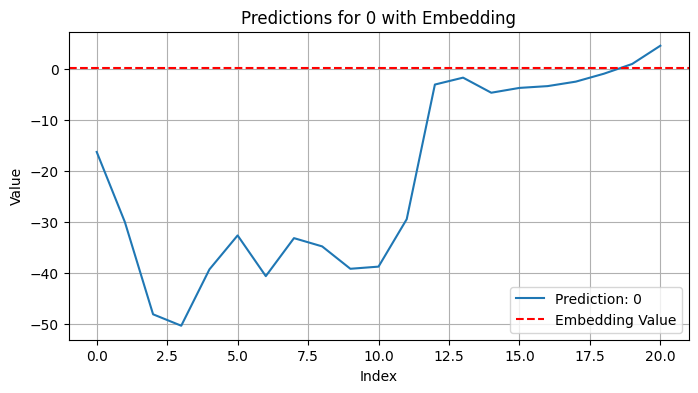

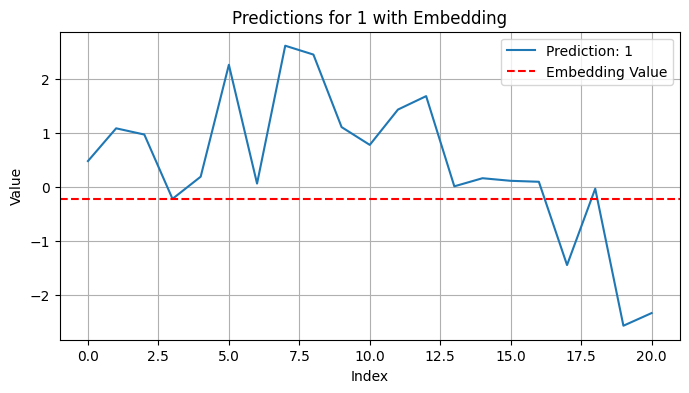

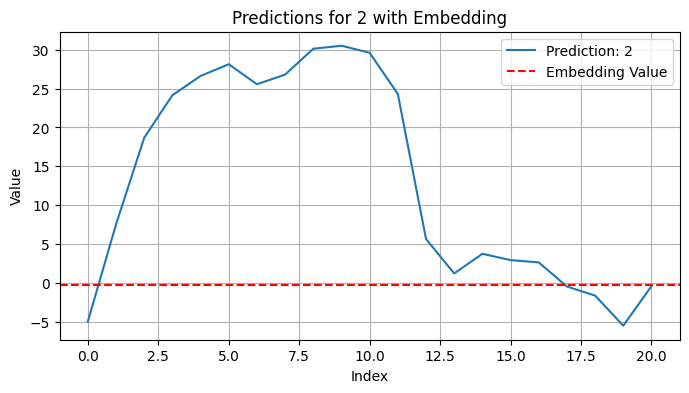

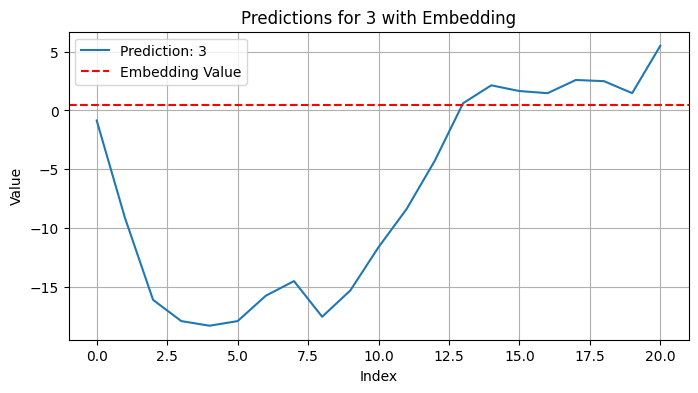

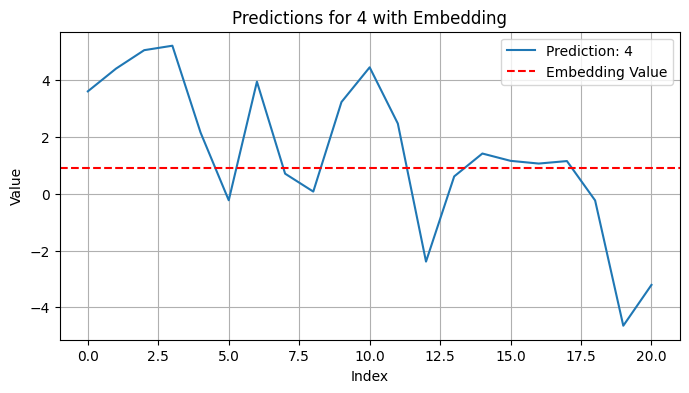

...

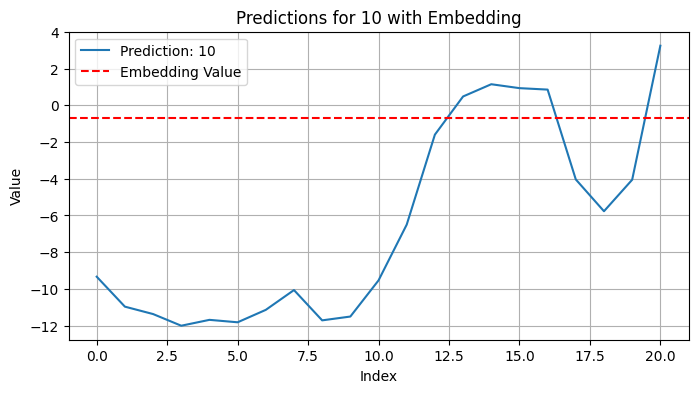

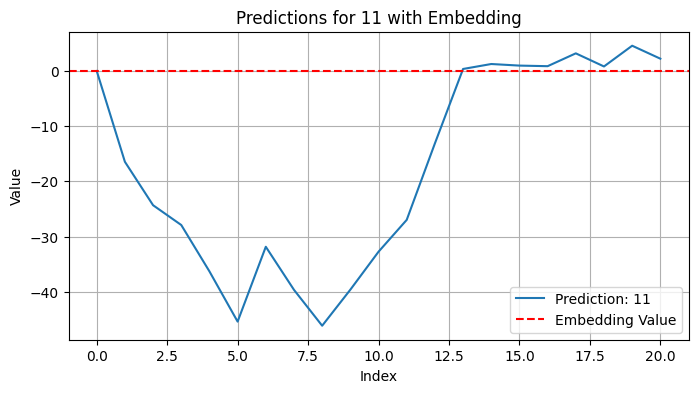

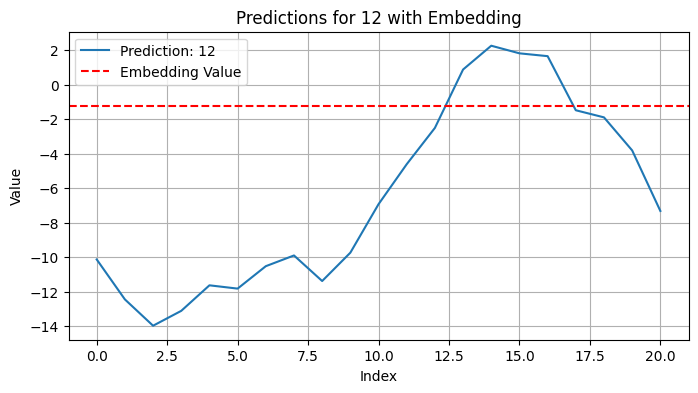

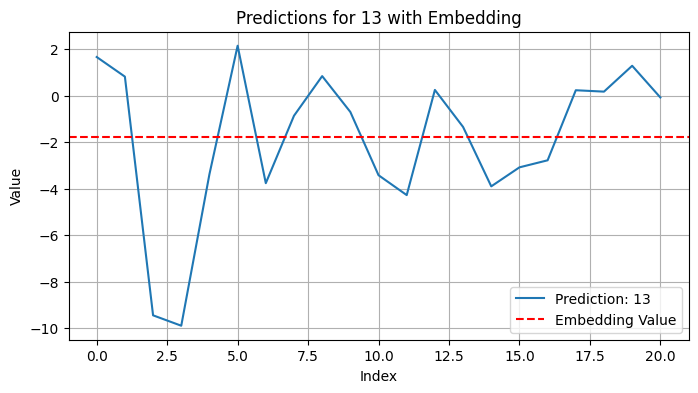

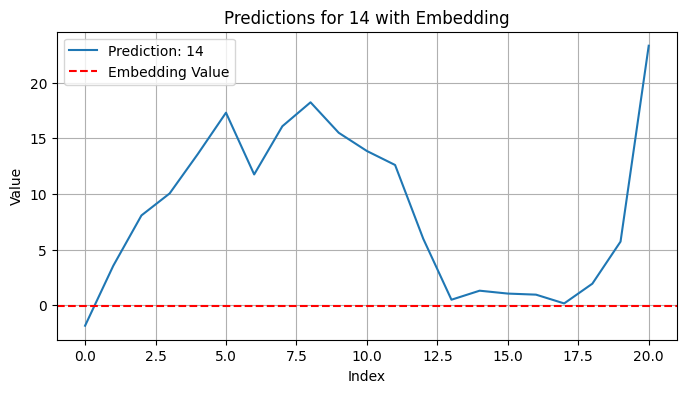

In [143]:
plot_predictions_with_embedding('00130H204', predictions=predictions, sp_500_flattened=sp_500_flattened)